## Requirements.txt

In [ ]:
!pip install -r requirements.txt

## MANAGE IMPORTS

In [1]:
import torch
from IPython.display import Image 
import os
from random import choice
import shutil


In [ ]:
### GIT CLONE for YOLOV5  only once while setup

In [2]:
!git clone https://github.com/ultralytics/yolov5

Cloning into 'yolov5'...


In [3]:
%cd yolov5

D:\SELF\Insect_classication\yolov5


In [4]:
!pip install -r requirements.txt

In [ ]:
## CONSTANTS

In [5]:
IMG_SIZE = 415
BATCH_SIZE = 16
EPOCHS = 30

In [28]:
#arrays to store file names
BASE_DIR = 'D:\SELF\Insect_classication\\'

#setup dir names
trainPath =BASE_DIR+'res\images\TRAIN'
valPath = BASE_DIR+'res\images\VAL'

crsPath_1 = BASE_DIR+'res\DATASET\Eocanthecona_Bug_A' #dir where actual dataset
crsPath_2 = BASE_DIR+'res\DATASET\Larva_Spodoptera_D' 
crsPath_3 = BASE_DIR+'res\DATASET\Red_Hairy_Catterpillar_C' 
crsPath_4 = BASE_DIR+'res\DATASET\Tobacco_Caterpillar_B' 

#setup ratio (val ratio = rest of the files in origin dir after splitting into train and test)
train_ratio = 0.8
val_ratio = 0.2


#total count of imgs
totalImgCount = 0
totalImgCount += len(os.listdir(crsPath_1))/2
totalImgCount += len(os.listdir(crsPath_2))/2
totalImgCount += len(os.listdir(crsPath_3))/2
totalImgCount += len(os.listdir(crsPath_4))/2

#soring files to corresponding arrays
imgs =[]
xmls =[]
for (dirname, dirs, files) in os.walk(crsPath_1):
    for filename in files:
        if filename.endswith('.txt'):
            xmls.append(filename)
        else:
            imgs.append(filename)

for (dirname, dirs, files) in os.walk(crsPath_2):
    for filename in files:
        if filename.endswith('.txt'):
            xmls.append(filename)
        else:
            imgs.append(filename)

for (dirname, dirs, files) in os.walk(crsPath_3):
    for filename in files:
        if filename.endswith('.txt'):
            xmls.append(filename)
        else:
            imgs.append(filename)

for (dirname, dirs, files) in os.walk(crsPath_4):
    for filename in files:
        if filename.endswith('.txt'):
            xmls.append(filename)
        else:
            imgs.append(filename)


#counting range for cycles
countForTrain = int(len(imgs)*train_ratio)
countForVal = int(len(imgs)*val_ratio)
print("training images are : ",countForTrain)
print("Validation images are : ",countForVal)

training images are :  3063
Validation images are :  765


In [ ]:
trainimagePath = BASE_DIR+'res\images\TRAIN'
trainlabelPath = BASE_DIR+'res\labels\TRAIN'
valimagePath = BASE_DIR+'res\images\VAL'
vallabelPath = BASE_DIR+'res\labels\VAL'
#cycle for train dir
for x in range(countForTrain):

    fileJpg = choice(imgs) # get name of random image from origin dir
    fileXml = fileJpg[:-4] +'.txt' # get name of corresponding annotation file

    #move both files into train dir
    #shutil.move(os.path.join(crsPath, fileJpg), os.path.join(trainimagePath, fileJpg))
    #shutil.move(os.path.join(crsPath, fileXml), os.path.join(trainlabelPath, fileXml))
    
    shutil.copy(os.path.join(crsPath_1, fileJpg), os.path.join(trainimagePath, fileJpg))
    shutil.copy(os.path.join(crsPath_1, fileXml), os.path.join(trainlabelPath, fileXml))
    
    shutil.copy(os.path.join(crsPath_2, fileJpg), os.path.join(trainimagePath, fileJpg))
    shutil.copy(os.path.join(crsPath_2, fileXml), os.path.join(trainlabelPath, fileXml))
    shutil.copy(os.path.join(crsPath_3, fileJpg), os.path.join(trainimagePath, fileJpg))
    shutil.copy(os.path.join(crsPath_3, fileXml), os.path.join(trainlabelPath, fileXml))
    shutil.copy(os.path.join(crsPath_4, fileJpg), os.path.join(trainimagePath, fileJpg))
    shutil.copy(os.path.join(crsPath_4, fileXml), os.path.join(trainlabelPath, fileXml))


    #remove files from arrays
    imgs.remove(fileJpg)
    xmls.remove(fileXml)



#cycle for test dir   
for x in range(countForVal):

    fileJpg = choice(imgs) # get name of random image from origin dir
    fileXml = fileJpg[:-4] +'.txt' # get name of corresponding annotation file

    #move both files into train dir
    shutil.copy(os.path.join(crsPath_1, fileJpg), os.path.join(valimagePath, fileJpg))
    shutil.copy(os.path.join(crsPath_1, fileXml), os.path.join(vallabelPath, fileXml))

    shutil.copy(os.path.join(crsPath_2, fileJpg), os.path.join(valimagePath, fileJpg))
    shutil.copy(os.path.join(crsPath_2, fileXml), os.path.join(vallabelPath, fileXml))
    shutil.copy(os.path.join(crsPath_3, fileJpg), os.path.join(valimagePath, fileJpg))
    shutil.copy(os.path.join(crsPath_3, fileXml), os.path.join(vallabelPath, fileXml))
    shutil.copy(os.path.join(crsPath_4, fileJpg), os.path.join(valimagePath, fileJpg))
    shutil.copy(os.path.join(crsPath_4, fileXml), os.path.join(vallabelPath, fileXml))

    #remove files from arrays
    imgs.remove(fileJpg)
    xmls.remove(fileXml)

#rest of files will be validation files, so rename origin dir to val dir
#os.rename(crsPath, valPath)
#shutil.move(crsPath, valPath) 

In [ ]:
## TRAINING from YOLO MOdel

In [29]:
%cd yolov5

[WinError 2] The system cannot find the file specified: 'yolov5'
D:\SELF\Insect_classication\yolov5


In [45]:
!python train.py --img 512 --batch 16 --epochs 30 --data dataset.yaml --weights yolov5s.pt --cache

### At the end of the training, two files should be saved in yolov5/runs/train/exp/weights: last.pt and best.pt. We’ll use best.pt.


In [ ]:

%load_ext tensorboard
%tensorboard --logdir runs

## Original Image in TEST dir
### confident our model is. We can plot a validation batch obtained during training and inspect the confidence score of each label

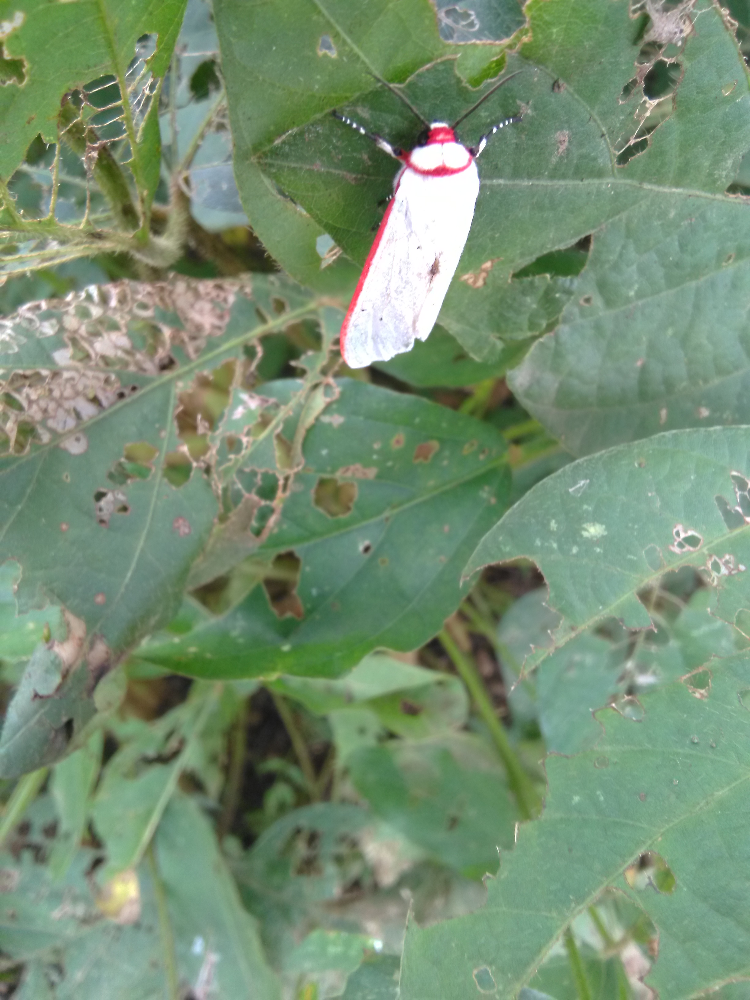

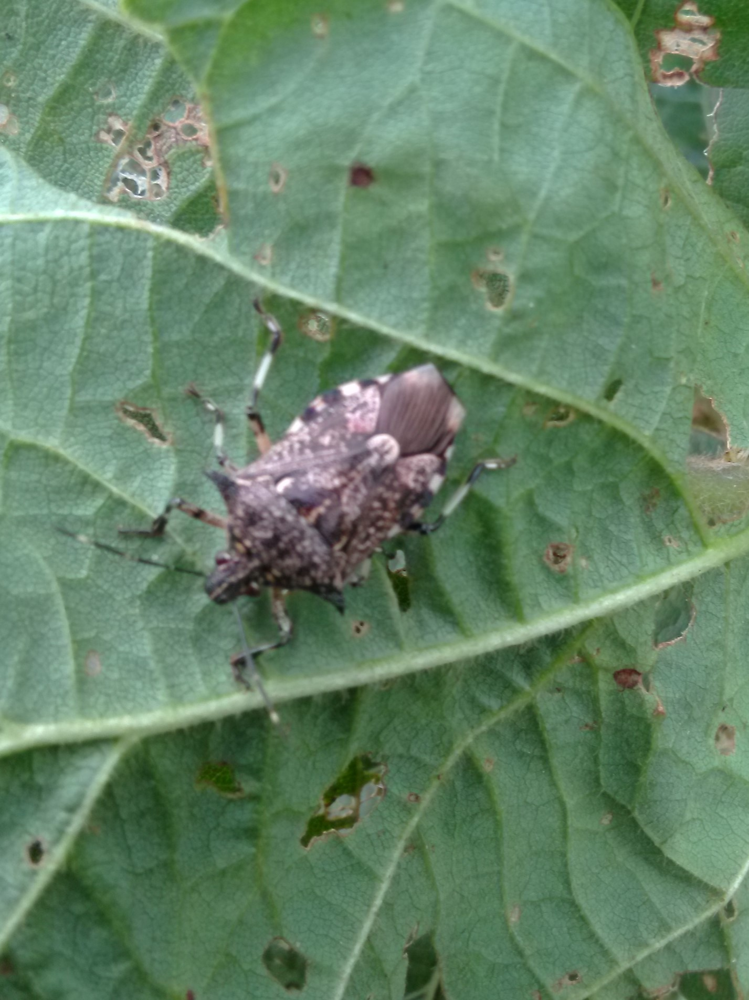

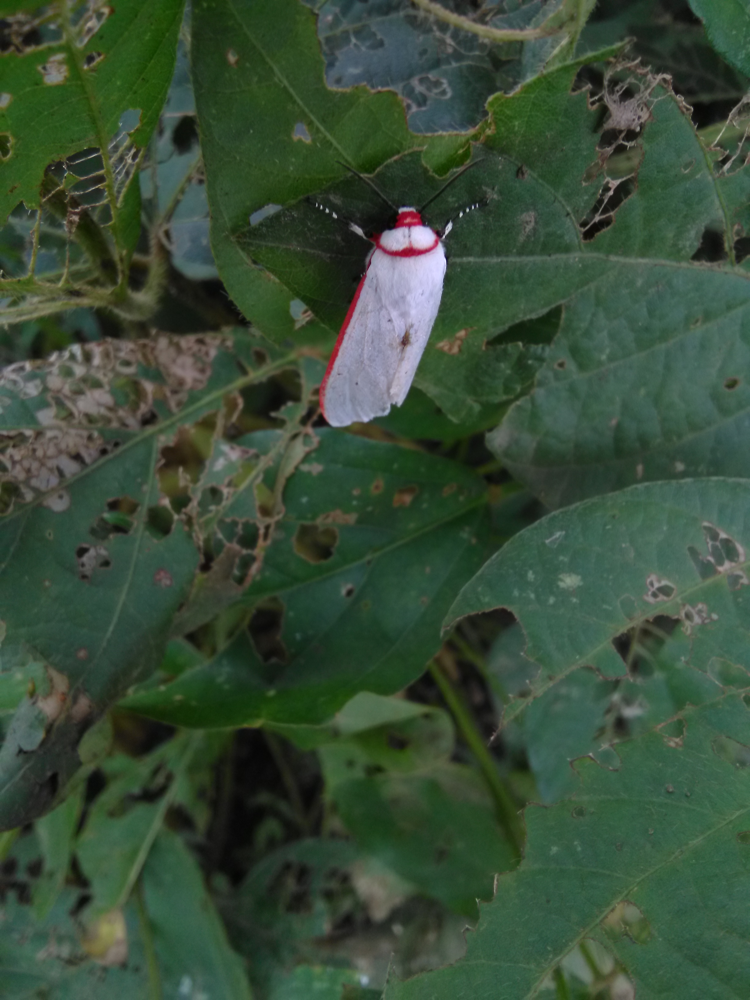

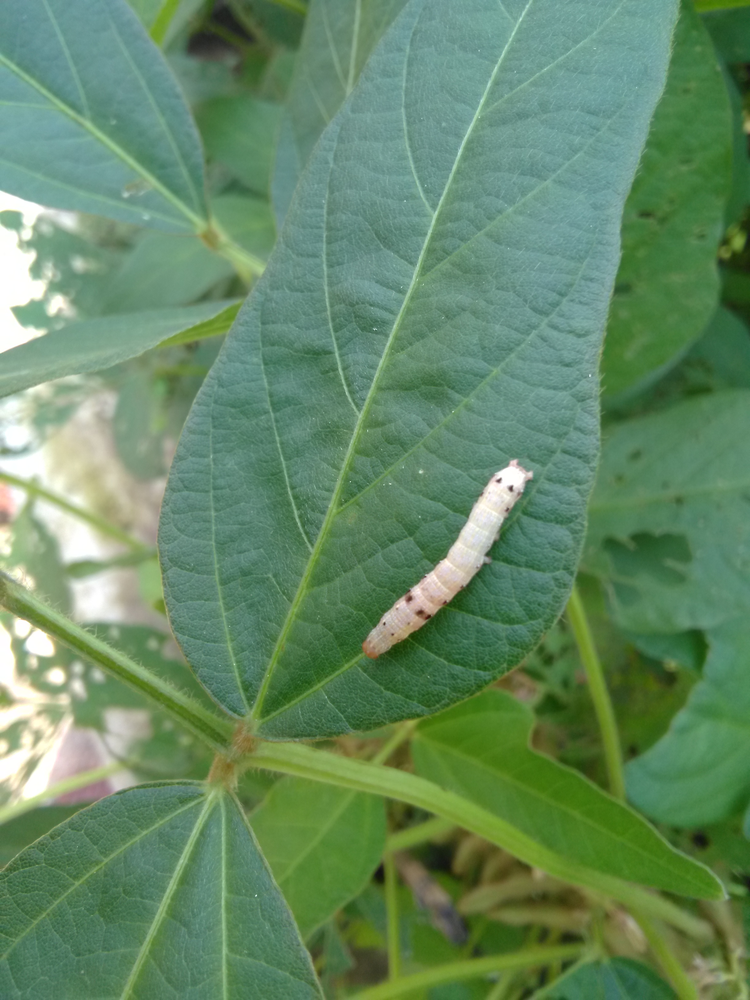

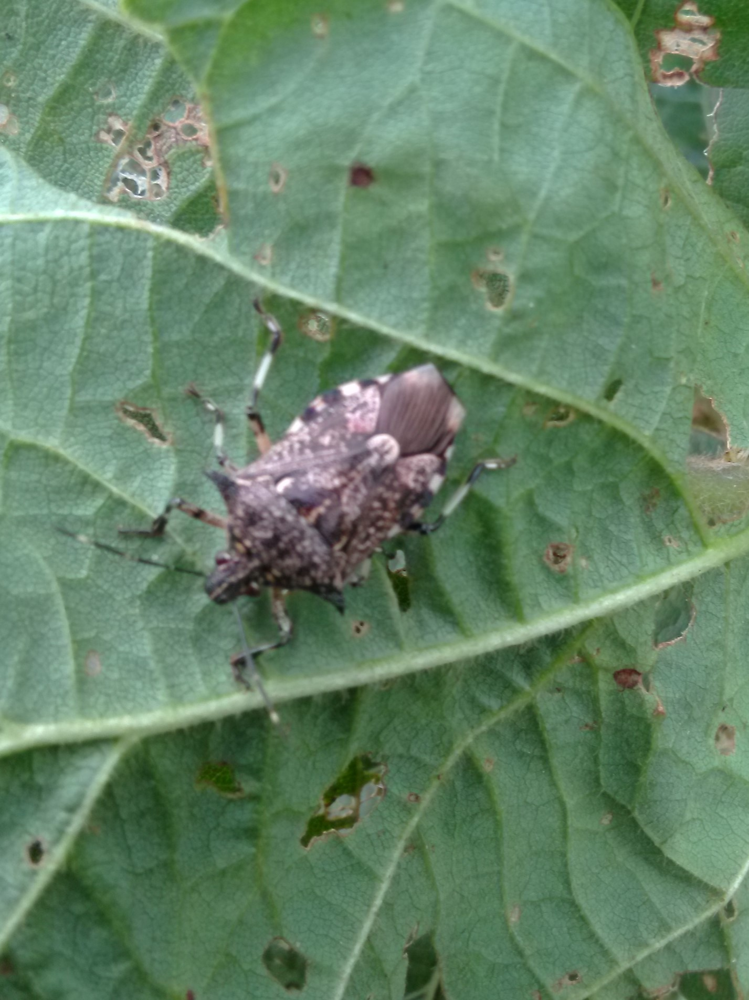

...

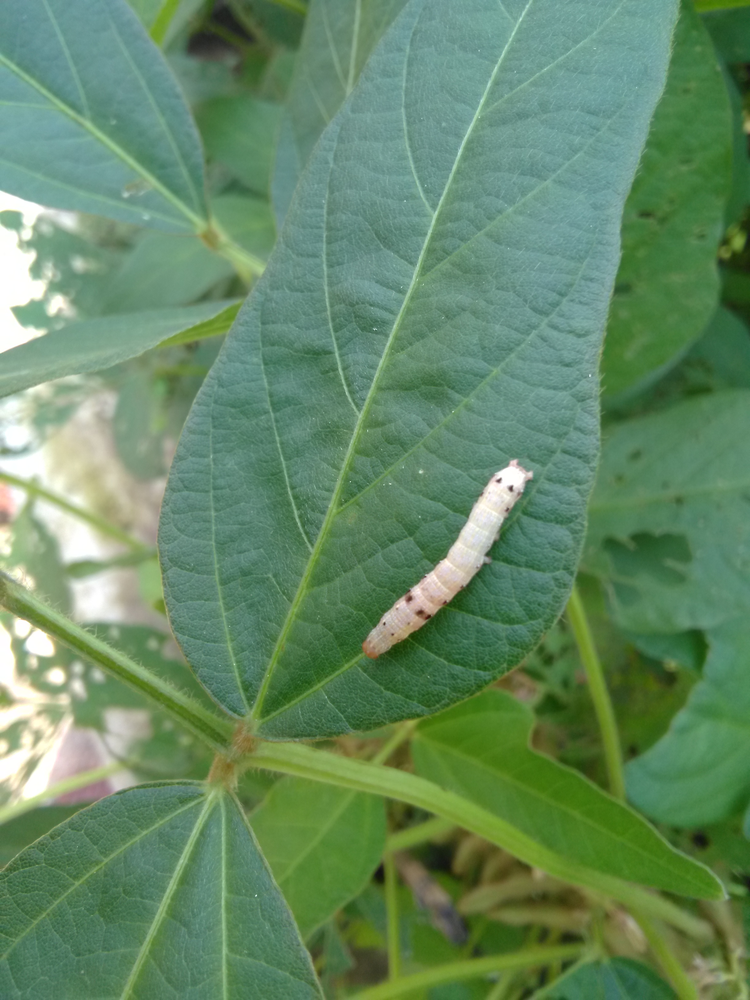

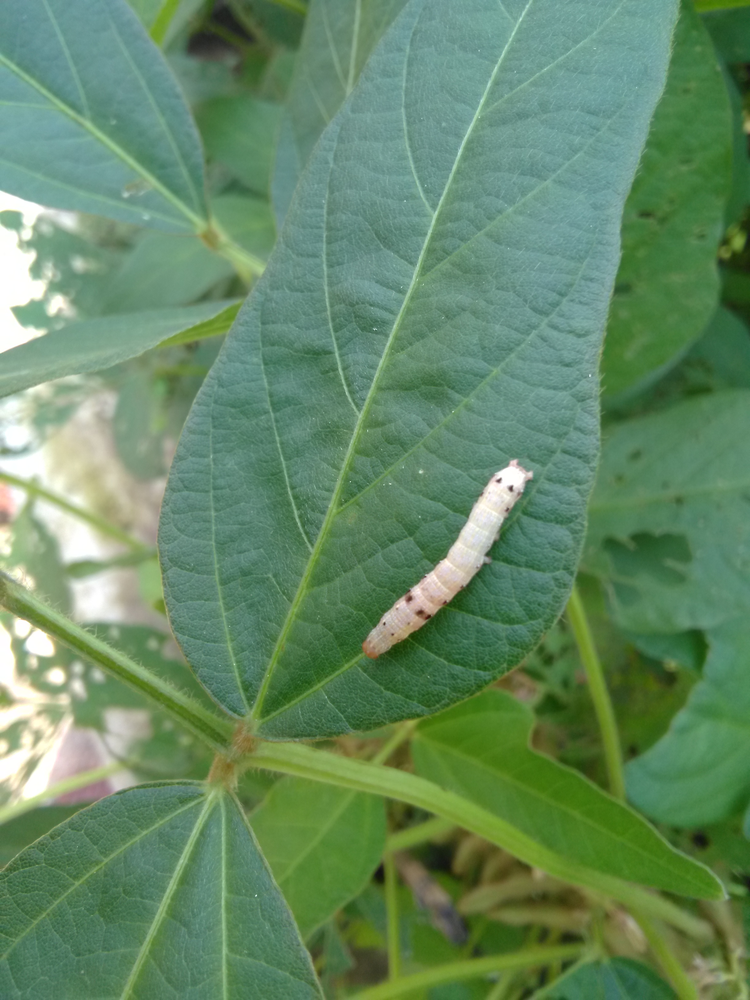

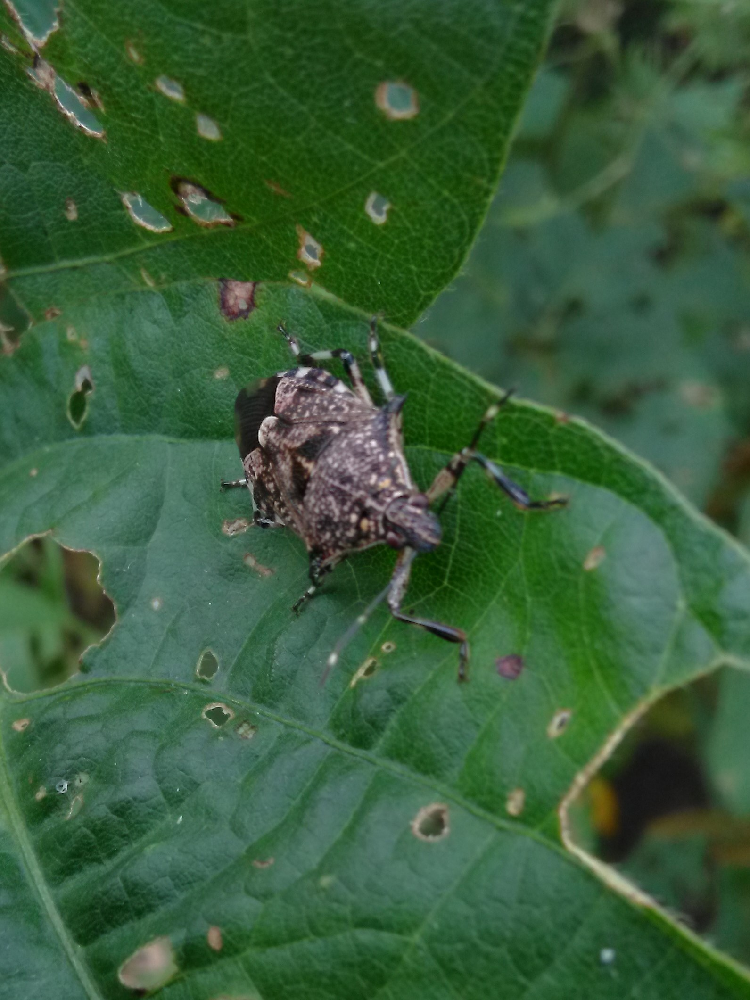

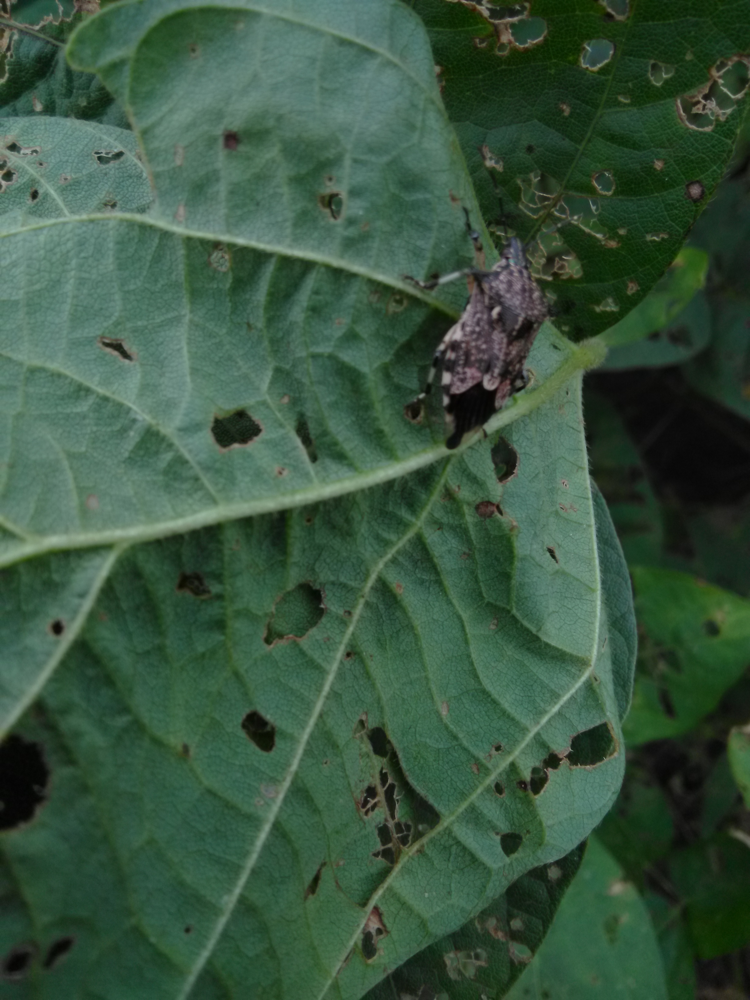

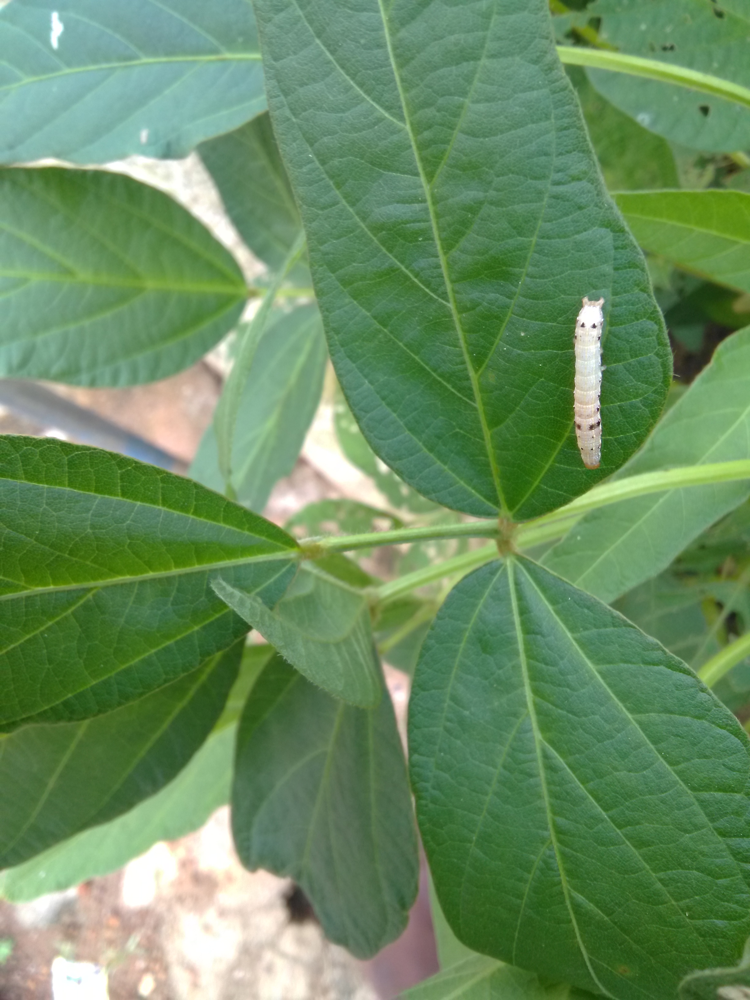

In [112]:
#PREDICT_IMAGE ='D:\SELF\Insect_classication\yolov5\runs\train\a.jpg'
PREDICT_IMAGE = ''
for name in range(1,12):
    display(Image(filename='runs/train/TEST/'+str(name)+'.jpg', width=128))


## Making the Prediction
## `` --source TEST/ImgName.jpg ``

In [107]:
!python detect.py --source ./runs/train/TEST/ --data ./yolov5/dataset.yaml --weights yolov5s.pt --line-thickness 30 --hide-labels

detect: weights=['yolov5s.pt'], source=./runs/train/TEST/, data=./yolov5/dataset.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=30, hide_labels=True, hide_conf=False, half=False, dnn=False
YOLOv5  v6.2-84-gea98199 Python-3.9.12 torch-1.12.0+cpu CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
image 1/11 D:\SELF\Insect_classication\yolov5\runs\train\TEST\1.jpg: 640x480 1 bird, 307.0ms
image 2/11 D:\SELF\Insect_classication\yolov5\runs\train\TEST\10.jpg: 640x480 (no detections), 279.2ms
image 3/11 D:\SELF\Insect_classication\yolov5\runs\train\TEST\11.jpg: 640x480 (no detections), 271.4ms
image 4/11 D:\SELF\Insect_classication\yolov5\runs\train\TEST\2.jpg: 640x480 1 bird, 284.4ms
image 5/11 D:\SELF\Insec

## Plotting the predicted result on test_dataset

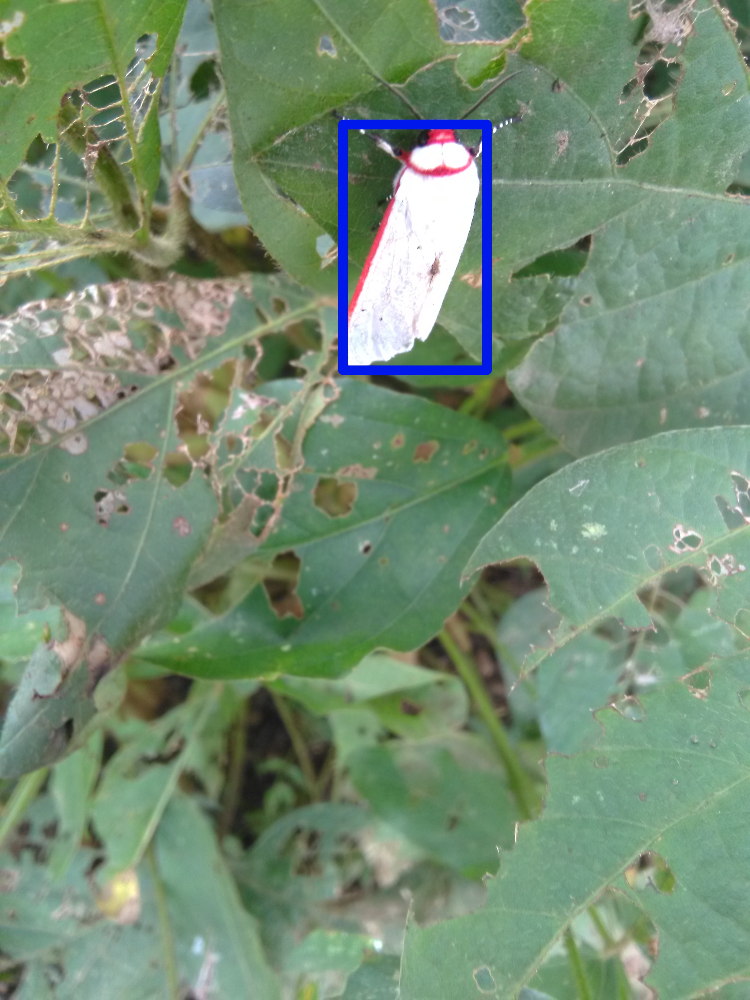

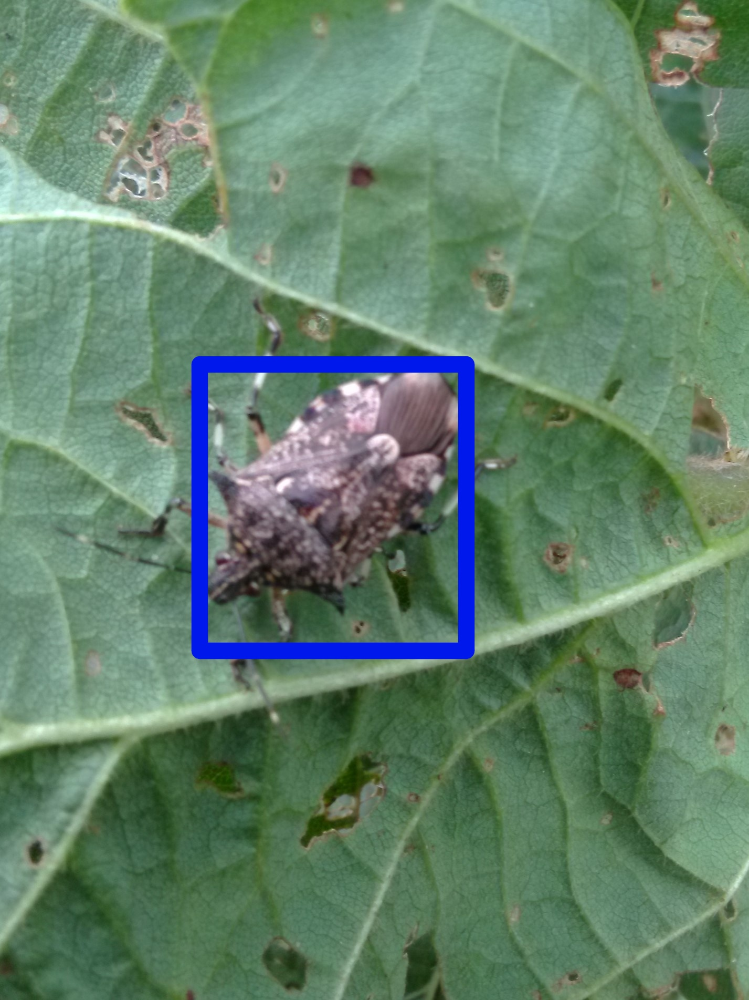

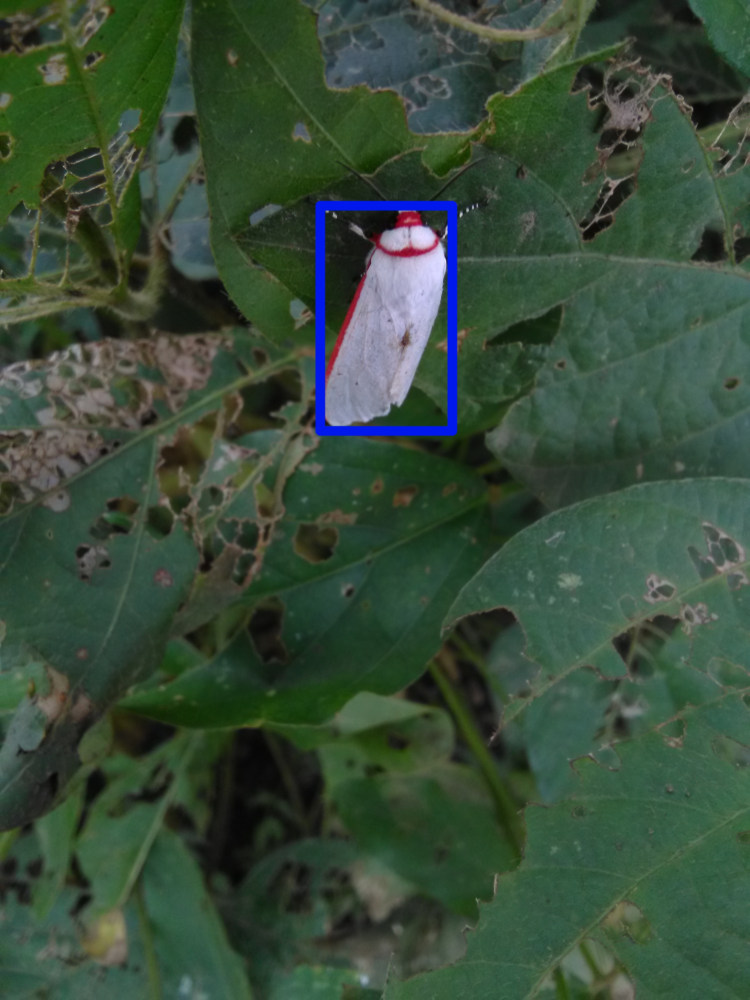

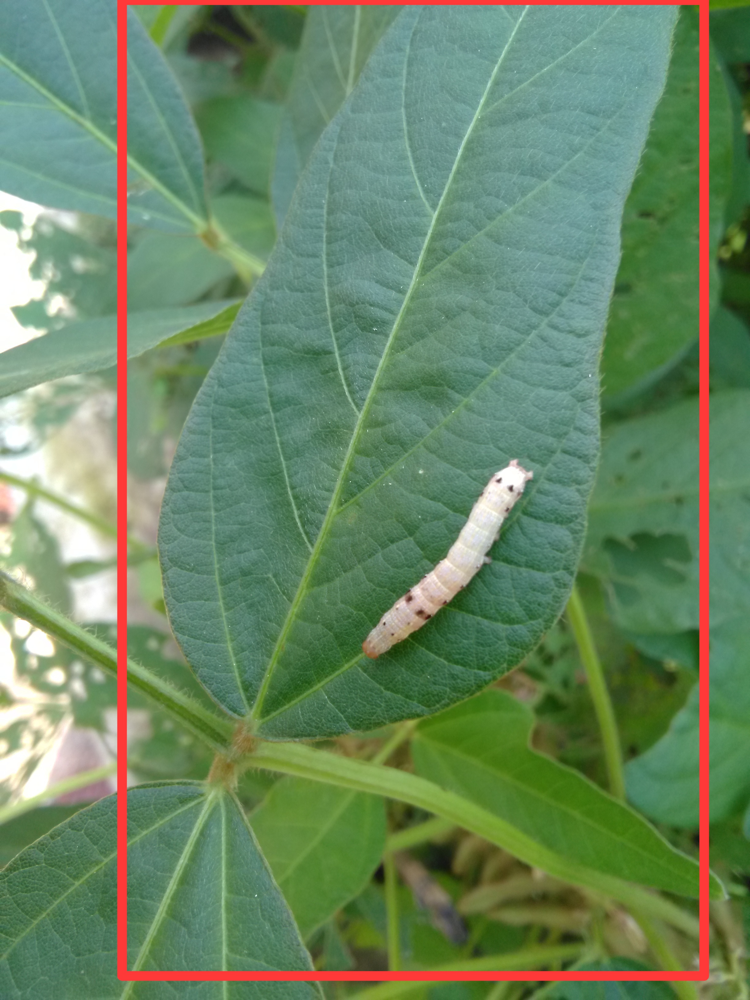

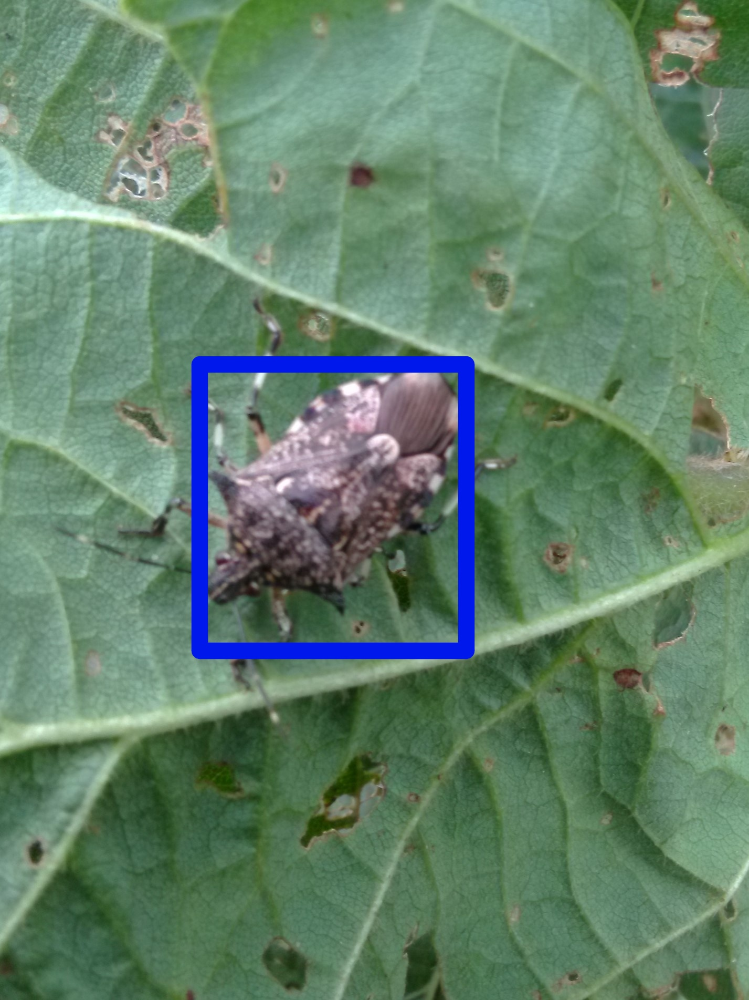

...

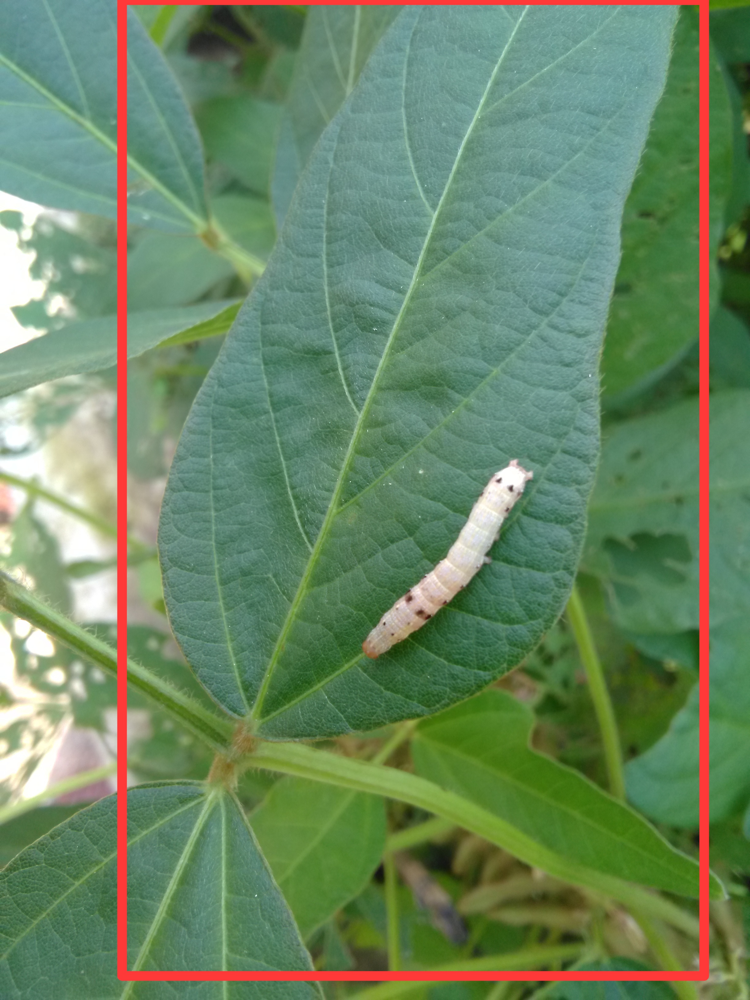

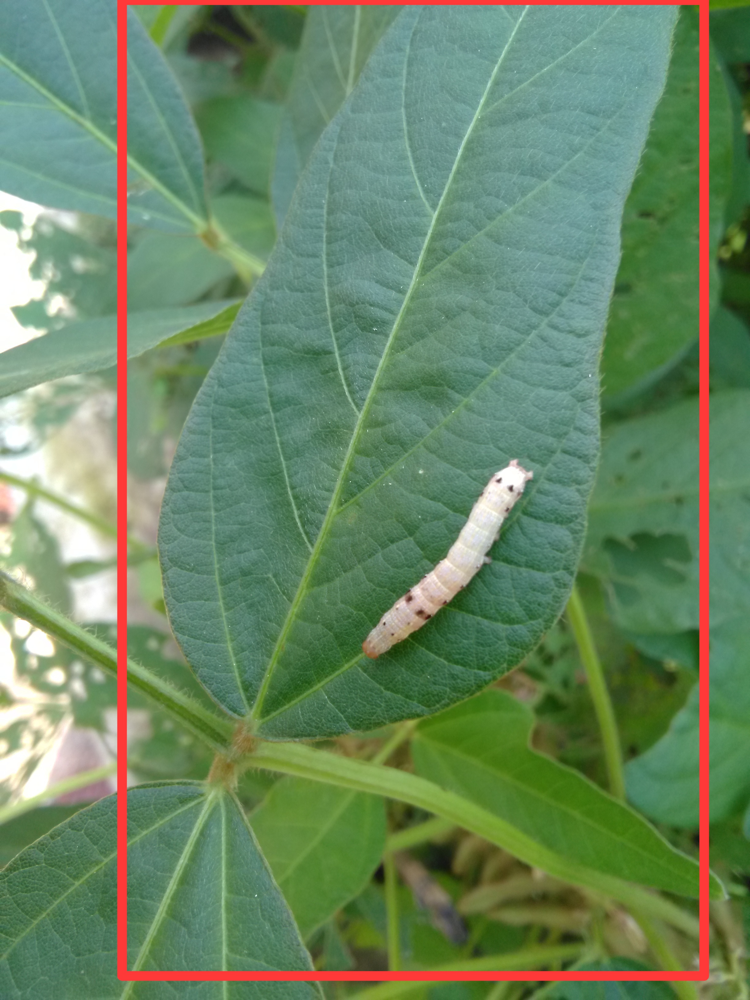

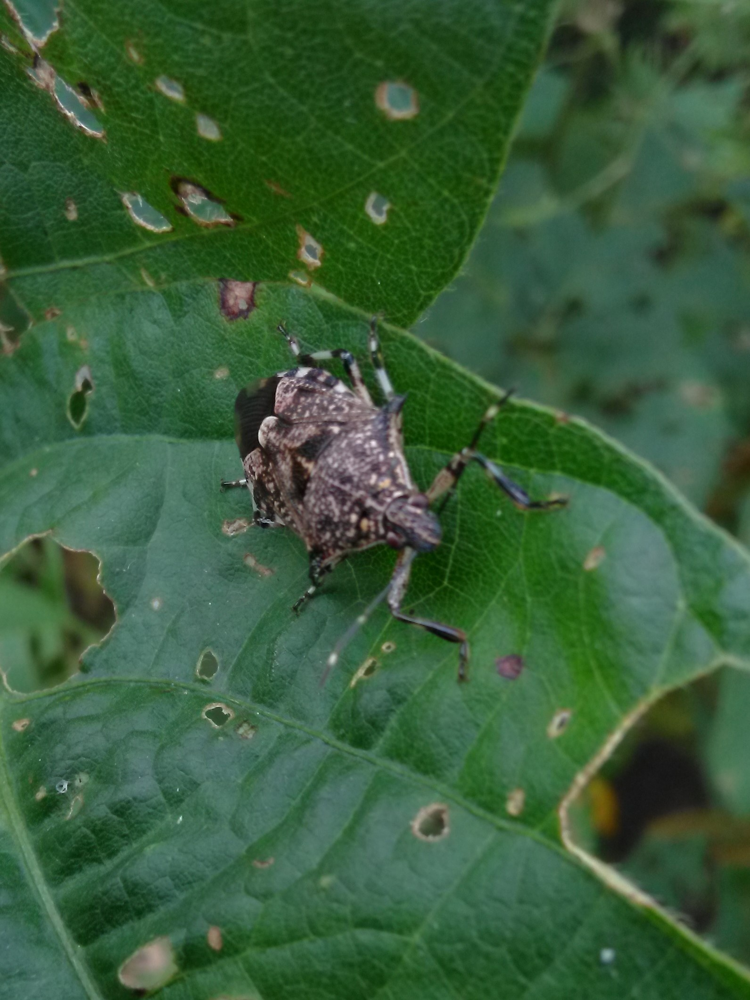

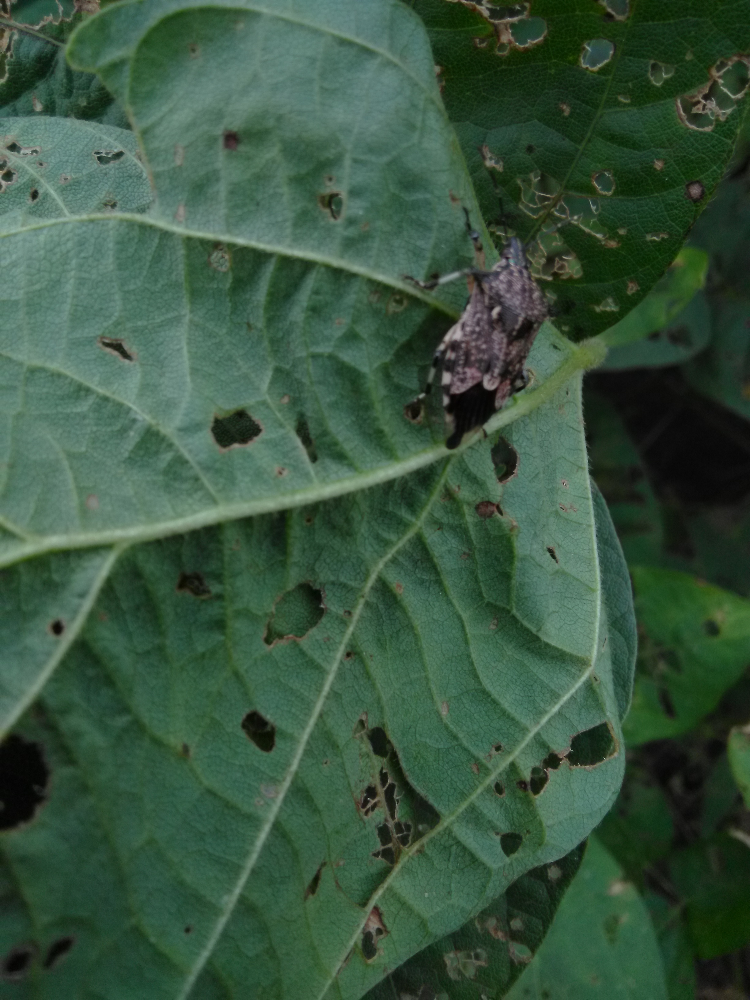

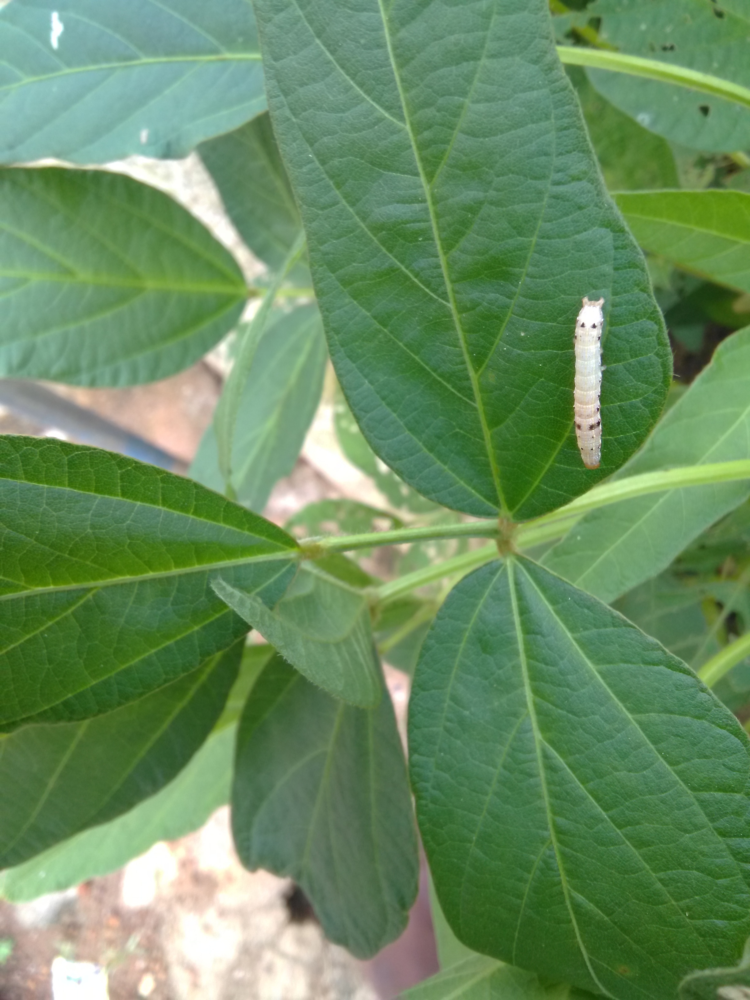

In [109]:
EXP_NO = "2"
for name in range(1,12):
    display(Image(filename='runs/detect/exp'+EXP_NO+'/'+str(name)+'.jpg', width=128))
    #Image(filename='runs/detect/exp'+EXP_NO+''/'+str(name)+'.jpg', width=256)

## Saving the result in runs/TEST-EXP

In [88]:
from utils.plots import plot_results 
plot_results(save_dir='runs/TEST-EXP')  # plot results.txt as results.png

TypeError: plot_results() got an unexpected keyword argument 'save_dir'

<div class="alert alert-block alert-danger">
    <b>END</b>Project</div>